# Part 2: Audio Image Text CLIP Embeddings

## Environmental sound demo

Dataset: https://github.com/karolpiczak/ESC-50

In [1]:
!cat ../../requirements-audio.txt

transformers
pillow
scipy
torch
requests
pandas
seaborn
matplotlib
tqdm
torchvision
scikit-learn
memory_profiler
setuptools
librosa
numpy<2
wav2clip


In [1]:
!ls ../../data/ESC-50-master

audio      embeddings meta


In [2]:

!ls ../../data/ESC-50-master/audio

1-100032-A-0.wav  2-118624-A-30.wav 3-151212-A-24.wav 4-196671-A-8.wav
1-100038-A-14.wav 2-118625-A-30.wav 3-151213-A-24.wav 4-196671-B-8.wav
1-100210-A-36.wav 2-118817-A-32.wav 3-151255-A-28.wav 4-196672-A-8.wav
1-100210-B-36.wav 2-118964-A-0.wav  3-151269-A-35.wav 4-197103-A-6.wav
1-101296-A-19.wav 2-119102-A-21.wav 3-151273-A-35.wav 4-197454-A-28.wav
1-101296-B-19.wav 2-119139-A-31.wav 3-151557-A-28.wav 4-197454-B-28.wav
1-101336-A-30.wav 2-119161-A-8.wav  3-151557-B-28.wav 4-197871-A-15.wav
1-101404-A-34.wav 2-119161-B-8.wav  3-152007-A-20.wav 4-198025-A-23.wav
1-103298-A-9.wav  2-119161-C-8.wav  3-152007-B-20.wav 4-198360-A-49.wav
1-103995-A-30.wav 2-119748-A-38.wav 3-152007-C-20.wav 4-198360-B-49.wav
1-103999-A-30.wav 2-120218-A-30.wav 3-152007-D-20.wav 4-198360-C-49.wav
1-104089-A-22.wav 2-120218-B-30.wav 3-152007-E-20.wav 4-198841-A-37.wav
1-104089-B-22.wav 2-120333-A-32.wav 3-152020-A-36.wav 4-198962-A-25.wav
1-105224-A-22.wav 2-120586-A-6.wav  3-152020-B-36.wav 4-198962-B-25.

In [3]:
from pathlib import Path

In [4]:
audio_files = sorted(Path("../../data/ESC-50-master/audio/").glob("*.wav"))

In [7]:
len(audio_files)

2000

In [9]:
import wav2clip

In [14]:
model = wav2clip.get_model() # /Users/alex/.cache/torch/hub/checkpoints/Wav2CLIP.pt

Downloading: "https://github.com/descriptinc/lyrebird-wav2clip/releases/download/v0.1.0-alpha/Wav2CLIP.pt" to /Users/alex/.cache/torch/hub/checkpoints/Wav2CLIP.pt
100%|██████████| 46.7M/46.7M [00:02<00:00, 20.2MB/s]


In [15]:
import librosa

In [17]:
waveform, sample_rate = librosa.load(audio_files[0], sr=None)

In [18]:
waveform

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

In [19]:
sample_rate

44100

In [20]:
embeddings = wav2clip.embed_audio(waveform, model)

In [21]:
embeddings.shape

(1, 512)

In [22]:
embeddings

array([[ 1.54250753e+00,  3.35114598e-02, -5.48730969e-01,
        -1.42937064e+00, -1.95366538e+00,  2.60803103e-01,
         5.05523920e-01,  6.83558822e-01,  2.43846074e-01,
        -2.23148197e-01, -7.26768017e-01,  9.88648534e-01,
         9.41388309e-03,  3.89437526e-01, -2.54441738e-01,
        -2.81005263e-01,  6.42263472e-01, -2.32909143e-01,
         1.94299862e-01,  6.54566050e-01,  4.43185836e-01,
        -2.72410989e-01,  8.28259587e-01, -5.07830858e-01,
        -4.62738901e-01,  9.22611892e-01, -1.74824297e-01,
         7.50957727e-02,  6.08881295e-01,  1.46958083e-01,
         9.04392242e-01,  1.47030520e+00, -7.30716825e-01,
        -8.02481472e-01, -2.25661397e-01,  7.01291323e-01,
         6.10894918e-01,  8.37677717e-02,  9.18708444e-01,
        -7.56103039e-01,  7.03104496e-01,  1.97666734e-02,
         1.24768329e+00,  2.54343390e-01, -7.16810226e-02,
         1.18804824e+00, -1.09069276e+00,  1.66003346e-01,
        -2.38186002e-01,  4.82461452e-02,  1.82440653e-0

In [23]:
import torch

In [24]:
torch.tensor(embeddings)

tensor([[ 1.5425e+00,  3.3511e-02, -5.4873e-01, -1.4294e+00, -1.9537e+00,
          2.6080e-01,  5.0552e-01,  6.8356e-01,  2.4385e-01, -2.2315e-01,
         -7.2677e-01,  9.8865e-01,  9.4139e-03,  3.8944e-01, -2.5444e-01,
         -2.8101e-01,  6.4226e-01, -2.3291e-01,  1.9430e-01,  6.5457e-01,
          4.4319e-01, -2.7241e-01,  8.2826e-01, -5.0783e-01, -4.6274e-01,
          9.2261e-01, -1.7482e-01,  7.5096e-02,  6.0888e-01,  1.4696e-01,
          9.0439e-01,  1.4703e+00, -7.3072e-01, -8.0248e-01, -2.2566e-01,
          7.0129e-01,  6.1089e-01,  8.3768e-02,  9.1871e-01, -7.5610e-01,
          7.0310e-01,  1.9767e-02,  1.2477e+00,  2.5434e-01, -7.1681e-02,
          1.1880e+00, -1.0907e+00,  1.6600e-01, -2.3819e-01,  4.8246e-02,
          1.8244e-01, -2.7700e-01, -3.0391e-01, -4.0800e-01, -2.6935e-01,
          1.4849e+00,  4.3685e-01, -7.9807e-02, -8.4398e-02, -4.5414e-01,
         -2.0863e-01, -1.0145e+00,  1.7083e-01,  8.3298e-01,  2.6049e-01,
         -5.5620e-01,  2.5863e-02, -3.

In [26]:
import numpy as np
from itertools import batched

In [27]:
# Trying fresh audio embeddings with better processing

def load_audio(file_path, target_sr=22050):
    waveform, sr = librosa.load(file_path, sr=None)
    if sr != target_sr:
        waveform = librosa.resample(waveform, orig_sr=sr, target_sr=target_sr)
        sr = target_sr
    max_abs_value = np.max(np.abs(waveform))
    if max_abs_value > 0:
        waveform = waveform / max_abs_value
    return waveform, sr

# Function to get audio embedding using Wav2CLIP
def get_audio_embeddings(audio_files):
    model = wav2clip.get_model() # /Users/alex/.cache/torch/hub/checkpoints/Wav2CLIP.pt

    # waveforms = []
    embeddings = []
    for audio_file in audio_files:
        waveform, sample_rate = load_audio(audio_file)
        embedding = wav2clip.embed_audio(waveform, model)[0]
        embeddings.append(embedding)
        # waveforms.append(waveform)
    
    # waveform = np.stack(waveforms)
    return torch.tensor(np.stack(embeddings))
	
	
	
batch_size = 500
total_batches = int(np.ceil(len(audio_files)/batch_size))

i = 0
embedding_files = []
for audio_fps in batched(audio_files, batch_size):
    i += 1
    print(f"Processing batch {i}/{total_batches}")
    file_name = f"../../data/ESC-50-master/embeddings/batch_{i}.pt"
    torch.save(get_audio_embeddings(audio_fps), file_name)
    embedding_files.append(file_name)
	
	
audio_embeddings = torch.cat([torch.load(fp) for fp in embedding_files])

Processing batch 1/4
Processing batch 2/4
Processing batch 3/4
Processing batch 4/4


In [28]:
# Load images

!ls ../../data/unsplash-free-images/

akira-hojo-ZxGdri2EWzk-unsplash.jpg
alejandro-contreras-wTPp323zAEw-unsplash.jpg
alexandru-rotariu-o_QTeyGVWjQ-unsplash.jpg
amber-kipp-75715CVEJhI-unsplash.jpg
ambitious-studio-rick-barrett-YzpnPiEVk3k-unsplash.jpg
ankush-minda-7KKQG0eB_TI-unsplash.jpg
annie-spratt-_S0XzuaZLas-unsplash.jpg
anthony-rampersad-gXVCjlTyNtE-unsplash.jpg
arek-adeoye-ljoCgjs63SM-unsplash.jpg
benjamin-jopen-dQcj0H8BcmU-unsplash.jpg
brandon-morgan-3qucB7U2l7I-unsplash.jpg
chris-smith-ZeIFgSO3MAU-unsplash.jpg
cullan-smith-BdTtvBRhOng-unsplash.jpg
damir-kopezhanov-Z5tXjpTqwR8-unsplash.jpg
daniel-klein-ps9K6gMM1CE-unsplash.jpg
daniel-quiceno-m-4MQtWCxUrYc-unsplash.jpg
david-brooke-martin-dxtEFmAfkOk-unsplash.jpg
diana-polekhina-y3q-2m9zBoA-unsplash.jpg
dose-juice-UAyYiZqGlWc-unsplash.jpg
edgar-nKC772R_qog-unsplash.jpg
elena-mozhvilo-HRjdJddvPu8-unsplash.jpg
erda-estremera-eMX1aIAp9Nw-unsplash.jpg
ethan-AqInTSNNJxA-unsplash.jpg
filip-zrnzevic-_EMkxLdko9k-unsplash.jpg
florian-hahn-tHbt8-7p4eM-unsplash.jpg
george-pas

In [29]:
image_files = sorted(Path("../../data/unsplash-free-images").glob("*.jpg"))

In [30]:
image_files

[PosixPath('../../data/unsplash-free-images/akira-hojo-ZxGdri2EWzk-unsplash.jpg'),
 PosixPath('../../data/unsplash-free-images/alejandro-contreras-wTPp323zAEw-unsplash.jpg'),
 PosixPath('../../data/unsplash-free-images/alexandru-rotariu-o_QTeyGVWjQ-unsplash.jpg'),
 PosixPath('../../data/unsplash-free-images/amber-kipp-75715CVEJhI-unsplash.jpg'),
 PosixPath('../../data/unsplash-free-images/ambitious-studio-rick-barrett-YzpnPiEVk3k-unsplash.jpg'),
 PosixPath('../../data/unsplash-free-images/ankush-minda-7KKQG0eB_TI-unsplash.jpg'),
 PosixPath('../../data/unsplash-free-images/annie-spratt-_S0XzuaZLas-unsplash.jpg'),
 PosixPath('../../data/unsplash-free-images/anthony-rampersad-gXVCjlTyNtE-unsplash.jpg'),
 PosixPath('../../data/unsplash-free-images/arek-adeoye-ljoCgjs63SM-unsplash.jpg'),
 PosixPath('../../data/unsplash-free-images/benjamin-jopen-dQcj0H8BcmU-unsplash.jpg'),
 PosixPath('../../data/unsplash-free-images/brandon-morgan-3qucB7U2l7I-unsplash.jpg'),
 PosixPath('../../data/unsplash-

In [31]:
from transformers import CLIPModel, CLIPProcessor
from torchvision.utils import make_grid
from torchvision.io import read_image 
from torchvision import transforms

In [32]:
def load_transform_images(image_paths):
    target_size = (240, 240)
    reshape_transform = lambda image_tensor: transforms.Resize(target_size)(image_tensor).expand(3, -1, -1)
    # reshape_transform = lambda x: x
    images = [reshape_transform(read_image(image)) for image in image_paths]
    return images

def get_image_embeddings(image_paths):
    # Load the CLIP model
    clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
    clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

    images = load_transform_images(image_paths)
    inputs = clip_processor(images=images, return_tensors="pt")
    image_embeddings = clip_model.get_image_features(**inputs)
    return image_embeddings

In [33]:
image_embeddings = get_image_embeddings(image_files)

loading configuration file config.json from cache at /Users/alex/.cache/huggingface/hub/models--openai--clip-vit-base-patch32/snapshots/3d74acf9a28c67741b2f4f2ea7635f0aaf6f0268/config.json
`text_config` is `None`. Initializing the `CLIPTextConfig` with default values.
`vision_config` is `None`. initializing the `CLIPVisionConfig` with default values.
Model config CLIPConfig {
  "_name_or_path": "openai/clip-vit-base-patch32",
  "architectures": [
    "CLIPModel"
  ],
  "initializer_factor": 1.0,
  "logit_scale_init_value": 2.6592,
  "model_type": "clip",
  "projection_dim": 512,
  "text_config": {
    "bos_token_id": 0,
    "dropout": 0.0,
    "eos_token_id": 2,
    "model_type": "clip_text_model"
  },
  "transformers_version": "4.42.3",
  "vision_config": {
    "dropout": 0.0,
    "model_type": "clip_vision_model"
  }
}

loading weights file pytorch_model.bin from cache at /Users/alex/.cache/huggingface/hub/models--openai--clip-vit-base-patch32/snapshots/3d74acf9a28c67741b2f4f2ea7635f

In [34]:
image_embeddings.shape

torch.Size([70, 512])

In [35]:
image_embeddings[0]

tensor([ 5.0370e-01,  2.1616e-01,  8.0627e-03,  2.4421e-01,  2.7166e-01,
        -4.9929e-01,  4.2571e-01,  4.9951e-01,  3.2001e-01,  1.2269e-01,
         3.5290e-01, -3.2438e-01, -2.9236e-01, -8.4890e-02,  1.0655e-01,
        -1.3418e-01, -7.4033e-01, -6.7709e-03,  6.0191e-01,  2.0885e-01,
        -3.4963e-01,  9.4047e-02,  4.6431e-01, -9.1017e-03,  2.9064e-01,
         2.2434e-01, -7.2759e-02, -2.2898e-01, -8.3697e-02, -1.3590e-02,
         3.6735e-02,  4.7357e-01, -7.7230e-02,  3.1910e-01, -1.4995e-01,
         7.7609e-02, -3.8235e-01, -1.7711e-01,  1.7205e-01,  2.2649e-02,
        -1.5413e-01, -2.5272e-01, -2.1805e-01,  1.1047e-01, -3.7515e-01,
         7.9884e-02,  3.5169e-01, -1.6398e-01, -2.0143e-01,  1.1194e-01,
        -3.0632e-01,  5.2321e-02,  4.7932e-01, -1.1523e-01, -4.8433e-01,
         6.2707e-01, -5.4794e-01,  1.9863e-01,  3.7489e-02,  2.4452e-01,
        -2.3357e-01, -7.6522e-02,  1.6015e-01,  4.4554e-02, -2.5925e-01,
         2.3537e-01,  8.4864e-02,  3.4909e-02, -1.6

In [36]:
def rank_items(search_embedding: torch.Tensor, corpus_embeddings: torch.Tensor):
    cosine_similarity = torch.nn.CosineSimilarity()
    scores = cosine_similarity(search_embedding.unsqueeze(dim=0), corpus_embeddings)
    return scores.tolist()



In [37]:
rank_items(image_embeddings[0], audio_embeddings)

[0.07386509329080582,
 0.056779421865940094,
 0.05830788612365723,
 0.06735706329345703,
 0.07933127135038376,
 0.10230547189712524,
 0.08585941046476364,
 0.04539923369884491,
 0.1019381582736969,
 0.0913388729095459,
 0.08662620931863785,
 0.07191423326730728,
 0.0708395466208458,
 0.0851173847913742,
 0.09067939966917038,
 0.05590607598423958,
 0.08290015161037445,
 0.09741801023483276,
 0.08844374865293503,
 0.10392840206623077,
 0.13611143827438354,
 0.06666187942028046,
 0.02615782618522644,
 0.048254068940877914,
 0.05366897210478783,
 0.09154064208269119,
 0.07012909650802612,
 0.10726724565029144,
 0.059079304337501526,
 0.12284129112958908,
 0.03988097235560417,
 0.0866713672876358,
 0.09456293284893036,
 0.026342179626226425,
 0.07363078743219376,
 0.011629406362771988,
 0.09346068650484085,
 0.09115079790353775,
 0.028972646221518517,
 0.06505480408668518,
 0.04230612516403198,
 0.06493739038705826,
 0.07320492714643478,
 0.06408346444368362,
 0.07209066301584244,
 0.137750

In [44]:
from IPython.display import display, Audio

In [45]:
def rank_related_images(audio_file: str, images, image_embeddings, n_top_results=8):
    scores = rank_items(get_audio_embeddings([audio_file])[0], image_embeddings)

    sort_idx = np.argsort(scores)
    ranked_images = np.array(images)[sort_idx][::-1][:n_top_results]
    ranked_scores = np.array(scores)[sort_idx][::-1][:n_top_results]

    target_size = (500, 500)
    reshape_transform = lambda image_tensor: transforms.Resize(target_size)(image_tensor).expand(3, -1, -1)
    resized_images = [reshape_transform(read_image(image)) for image in ranked_images]
    grid = make_grid(resized_images)

    # grid = make_grid([read_image(image) for image in ranked_images])
    display(transforms.ToPILImage()(grid))

    display(Audio(audio_file))

    return ranked_images, ranked_scores

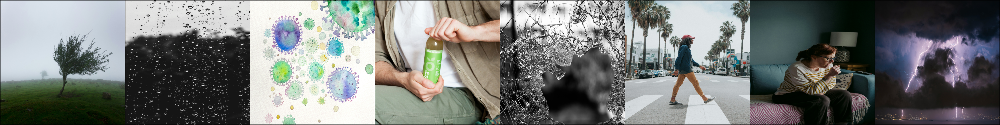

In [46]:
images, scores =    rank_related_images(audio_files[238], image_files, image_embeddings)

In [47]:
images

array([PosixPath('../../data/unsplash-free-images/khamkeo-vilaysing-WtwSsqwYlA0-unsplash.jpg'),
       PosixPath('../../data/unsplash-free-images/nick-nice-ve-R7PCjJDk-unsplash.jpg'),
       PosixPath('../../data/unsplash-free-images/elena-mozhvilo-HRjdJddvPu8-unsplash.jpg'),
       PosixPath('../../data/unsplash-free-images/dose-juice-UAyYiZqGlWc-unsplash.jpg'),
       PosixPath('../../data/unsplash-free-images/jilbert-ebrahimi-pVEcNabAg9o-unsplash.jpg'),
       PosixPath('../../data/unsplash-free-images/tyler-nix-VZEj0iepzKA-unsplash.jpg'),
       PosixPath('../../data/unsplash-free-images/annie-spratt-_S0XzuaZLas-unsplash.jpg'),
       PosixPath('../../data/unsplash-free-images/tasos-mansour-_hGPdpyMV-8-unsplash.jpg')],
      dtype=object)

In [48]:
scores

array([0.09218641, 0.09092597, 0.08741929, 0.07728177, 0.07616396,
       0.07524033, 0.07238957, 0.07191384])

In [49]:
import matplotlib.pyplot as plt

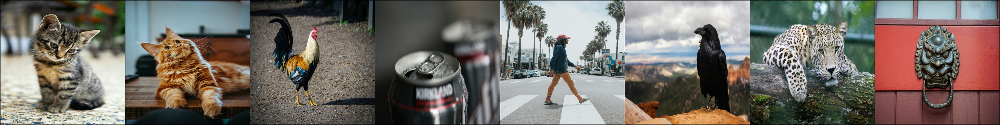

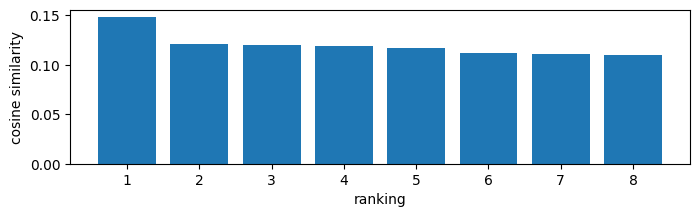

------------------------------------------------------------------------------------------------------------------------------------------------------


In [68]:
np.random.seed(2)
for audio_file in np.random.choice(audio_files, 1):
    ranked_images, ranked_scores = rank_related_images(audio_file, image_files, image_embeddings)
    plt.figure(figsize=(8,2))
    plt.bar(list(range(1, len(ranked_scores)+1)), ranked_scores)
    plt.ylabel("cosine similarity")
    plt.xlabel("ranking")
    plt.show()
    print("-"*150)

In [ ]:
np.random.seed(2)
for audio_file in np.random.choice(audio_files, 10):
    ranked_images, ranked_scores = rank_related_images(audio_file, image_files, image_embeddings)
    plt.figure(figsize=(8,2))
    plt.bar(list(range(1, len(ranked_scores)+1)), ranked_scores)
    plt.ylabel("cosine similarity")
    plt.xlabel("ranking")
    plt.show()
    print("-"*150)

In [53]:
from IPython.display import Image

In [54]:
def rank_related_audio(image_file, audio_files, audio_embeddings, n_top_results=5):
    scores = rank_items(get_image_embeddings([image_file])[0], audio_embeddings)

    sort_idx = np.argsort(scores)
    ranked_audio_files = np.array(audio_files)[sort_idx][::-1][:n_top_results]
    ranked_scores = np.array(scores)[sort_idx][::-1][:n_top_results]

    display(Image(image_file, width="500px"))

    for audio_file in ranked_audio_files:
        display(Audio(audio_file))

    return ranked_audio_files, ranked_scores

loading configuration file config.json from cache at /Users/alex/.cache/huggingface/hub/models--openai--clip-vit-base-patch32/snapshots/3d74acf9a28c67741b2f4f2ea7635f0aaf6f0268/config.json
`text_config` is `None`. Initializing the `CLIPTextConfig` with default values.
`vision_config` is `None`. initializing the `CLIPVisionConfig` with default values.
Model config CLIPConfig {
  "_name_or_path": "openai/clip-vit-base-patch32",
  "architectures": [
    "CLIPModel"
  ],
  "initializer_factor": 1.0,
  "logit_scale_init_value": 2.6592,
  "model_type": "clip",
  "projection_dim": 512,
  "text_config": {
    "bos_token_id": 0,
    "dropout": 0.0,
    "eos_token_id": 2,
    "model_type": "clip_text_model"
  },
  "transformers_version": "4.42.3",
  "vision_config": {
    "dropout": 0.0,
    "model_type": "clip_vision_model"
  }
}

loading weights file pytorch_model.bin from cache at /Users/alex/.cache/huggingface/hub/models--openai--clip-vit-base-patch32/snapshots/3d74acf9a28c67741b2f4f2ea7635f

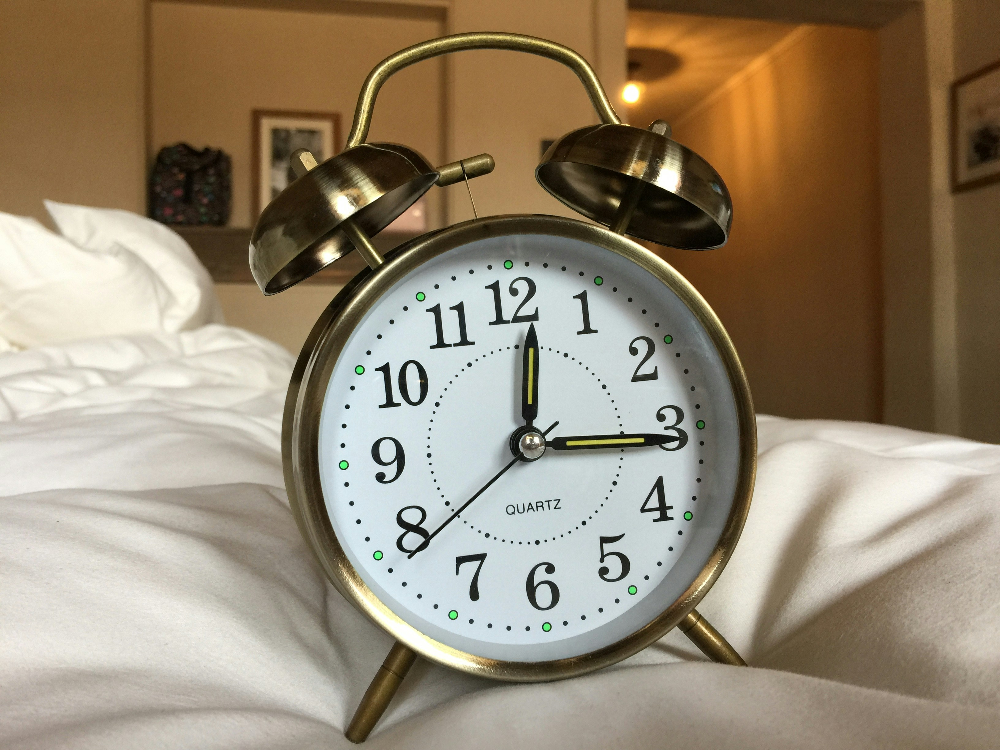

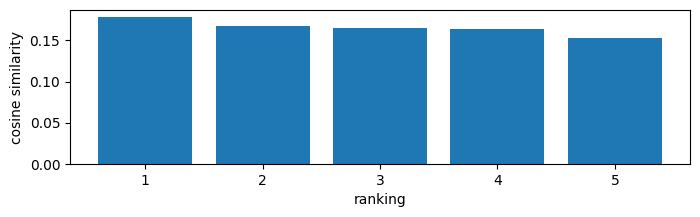

------------------------------------------------------------------------------------------------------------------------------------------------------


In [69]:
np.random.seed(1)
for image_file in np.random.choice(image_files, 1):
    ranked_audio_files, ranked_scores = rank_related_audio(image_file, audio_files, audio_embeddings)
    plt.figure(figsize=(8,2))
    plt.bar(list(range(1, len(ranked_scores)+1)), ranked_scores)
    plt.ylabel("cosine similarity")
    plt.xlabel("ranking")
    plt.show()
    print("-"*150)

In [ ]:
np.random.seed(1)
for image_file in np.random.choice(image_files, 10):
    ranked_audio_files, ranked_scores = rank_related_audio(image_file, audio_files, audio_embeddings)
    plt.figure(figsize=(8,2))
    plt.bar(list(range(1, len(ranked_scores)+1)), ranked_scores)
    plt.ylabel("cosine similarity")
    plt.xlabel("ranking")
    plt.show()
    print("-"*150)

In [60]:
def get_text_embedding(text):
    # Load the CLIP model
    clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
    clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

    inputs = clip_processor(text=[text], return_tensors="pt", padding=True)
    text_embeddings = clip_model.get_text_features(**inputs)
    return text_embeddings[0]


def rank_related_images_for_text(text, images, image_embeddings, n_top_results=8):
    text_embedding = get_text_embedding(text)
    scores = rank_items(text_embedding, image_embeddings)

    sort_idx = np.argsort(scores)
    ranked_images = np.array(images)[sort_idx][::-1][:n_top_results]
    ranked_scores = np.array(scores)[sort_idx][::-1][:n_top_results]

    target_size = (500, 500)
    reshape_transform = lambda image_tensor: transforms.Resize(target_size)(image_tensor).expand(3, -1, -1)
    resized_images = [reshape_transform(read_image(image)) for image in ranked_images]
    grid = make_grid(resized_images)

    # grid = make_grid([read_image(image) for image in ranked_images])
    display(transforms.ToPILImage()(grid))

    return ranked_images, ranked_scores



def rank_related_audio_for_text(text: str, audio_files, audio_embeddings, n_top_results=5):
    text_embedding = get_text_embedding(text)
    scores = rank_items(text_embedding, audio_embeddings)

    sort_idx = np.argsort(scores)
    ranked_audio_files = np.array(audio_files)[sort_idx][::-1][:n_top_results]
    ranked_scores = np.array(scores)[sort_idx][::-1][:n_top_results]

    for audio_file in ranked_audio_files:
        display(Audio(audio_file))

    return ranked_audio_files, ranked_scores



def display_related_content_for_text(text: str, audio_files, audio_embeddings, image_files, image_embeddings):
    # Related images
    ranked_image_files, ranked_image_scores = rank_related_images_for_text(text, image_files, image_embeddings)
    plt.figure(figsize=(8,2))
    plt.bar(list(range(1, len(ranked_image_scores)+1)), ranked_image_scores)
    plt.ylabel("cosine similarity")
    plt.xlabel("ranking")
    plt.show()

    # Related audio
    ranked_audio_files, ranked_audio_scores = rank_related_audio_for_text(text, audio_files, audio_embeddings)
    plt.figure(figsize=(8,2))
    plt.bar(list(range(1, len(ranked_audio_scores)+1)), ranked_audio_scores)
    plt.ylabel("cosine similarity")
    plt.xlabel("ranking")
    plt.show()

loading configuration file config.json from cache at /Users/alex/.cache/huggingface/hub/models--openai--clip-vit-base-patch32/snapshots/3d74acf9a28c67741b2f4f2ea7635f0aaf6f0268/config.json
`text_config` is `None`. Initializing the `CLIPTextConfig` with default values.
`vision_config` is `None`. initializing the `CLIPVisionConfig` with default values.
Model config CLIPConfig {
  "_name_or_path": "openai/clip-vit-base-patch32",
  "architectures": [
    "CLIPModel"
  ],
  "initializer_factor": 1.0,
  "logit_scale_init_value": 2.6592,
  "model_type": "clip",
  "projection_dim": 512,
  "text_config": {
    "bos_token_id": 0,
    "dropout": 0.0,
    "eos_token_id": 2,
    "model_type": "clip_text_model"
  },
  "transformers_version": "4.42.3",
  "vision_config": {
    "dropout": 0.0,
    "model_type": "clip_vision_model"
  }
}

loading weights file pytorch_model.bin from cache at /Users/alex/.cache/huggingface/hub/models--openai--clip-vit-base-patch32/snapshots/3d74acf9a28c67741b2f4f2ea7635f

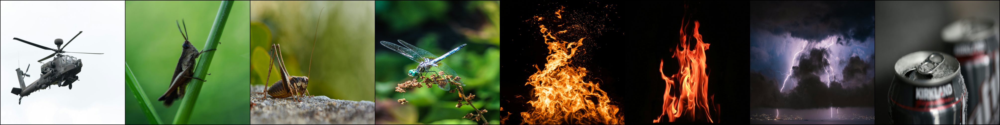

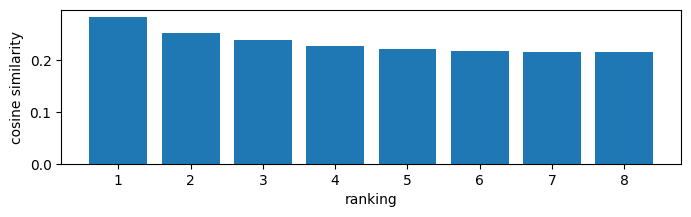

loading configuration file config.json from cache at /Users/alex/.cache/huggingface/hub/models--openai--clip-vit-base-patch32/snapshots/3d74acf9a28c67741b2f4f2ea7635f0aaf6f0268/config.json
`text_config` is `None`. Initializing the `CLIPTextConfig` with default values.
`vision_config` is `None`. initializing the `CLIPVisionConfig` with default values.
Model config CLIPConfig {
  "_name_or_path": "openai/clip-vit-base-patch32",
  "architectures": [
    "CLIPModel"
  ],
  "initializer_factor": 1.0,
  "logit_scale_init_value": 2.6592,
  "model_type": "clip",
  "projection_dim": 512,
  "text_config": {
    "bos_token_id": 0,
    "dropout": 0.0,
    "eos_token_id": 2,
    "model_type": "clip_text_model"
  },
  "transformers_version": "4.42.3",
  "vision_config": {
    "dropout": 0.0,
    "model_type": "clip_vision_model"
  }
}

loading weights file pytorch_model.bin from cache at /Users/alex/.cache/huggingface/hub/models--openai--clip-vit-base-patch32/snapshots/3d74acf9a28c67741b2f4f2ea7635f

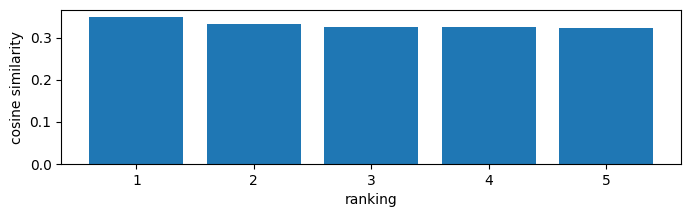

In [61]:
display_related_content_for_text("hellicopter", audio_files, audio_embeddings, image_files, image_embeddings)

In [ ]:
display_related_content_for_text("a hellicopter taking off", audio_files, audio_embeddings, image_files, image_embeddings)

In [ ]:
display_related_content_for_text("water", audio_files, audio_embeddings, image_files, image_embeddings)

In [ ]:
display_related_content_for_text("animal", audio_files, audio_embeddings, image_files, image_embeddings)

In [ ]:
display_related_content_for_text("people working at a construction site", audio_files, audio_embeddings, image_files, image_embeddings)